In [2]:
%pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.


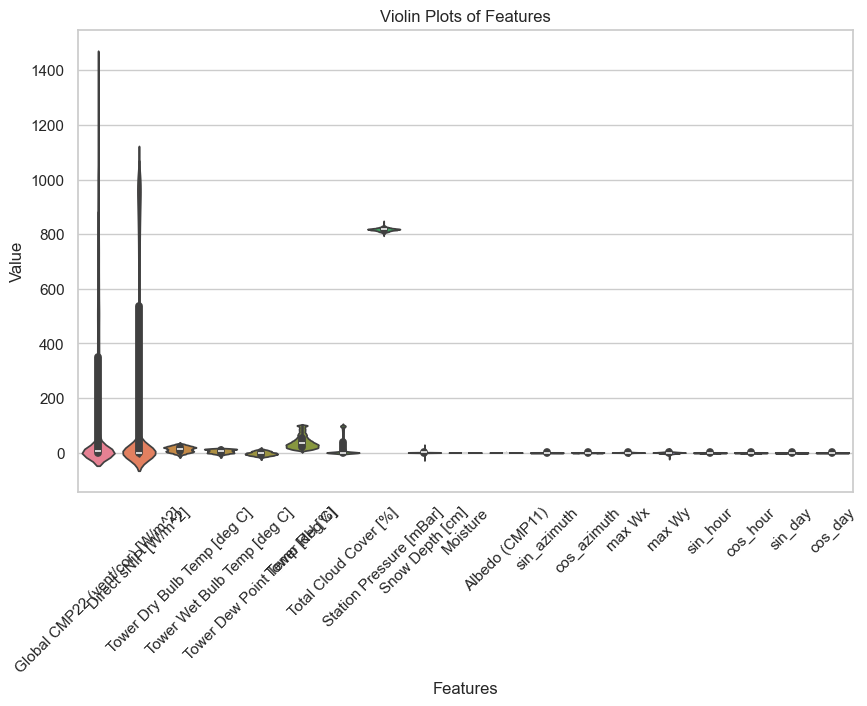

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np 
import pandas as pd 
import warnings
warnings.filterwarnings('ignore')
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
import plotly.graph_objs as go
import plotly.express as px
import joblib
from tqdm import tqdm
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import math
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense,Dropout,GRU,RNN,Conv1D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import optimizers, metrics, losses
from tensorflow.keras.callbacks import EarlyStopping


# Load your data
data = pd.read_csv('3.csv')

# Set the style of the visualization
sns.set(style="whitegrid")

# Create a violin plot for each feature in the dataset
plt.figure(figsize=(10, 6))  # Set the figure size
sns.violinplot(data=data)  # You can specify particular columns with data=data[['col1', 'col2']]

# Adding titles and labels
plt.title('Violin Plots of Features')
plt.ylabel('Value')
plt.xlabel('Features')

# Improve layout
plt.xticks(rotation=45)  # Rotate x labels for better readability if needed

plt.show()


In [4]:
scaler = MinMaxScaler()
# Get the index of the label column
label_column = "Total Cloud Cover [%]"
label_column_index = data.columns.get_loc(label_column)

# Determine the split point (e.g., 80% training, 20% testing)
split_point = int(len(data) * 0.9)

# Split the data into training and testing sets
train_data = data.iloc[:split_point]
test_data = data.iloc[split_point:]

train_data_scaled = scaler.fit_transform(train_data)
test_data_scaled = scaler.transform(test_data)



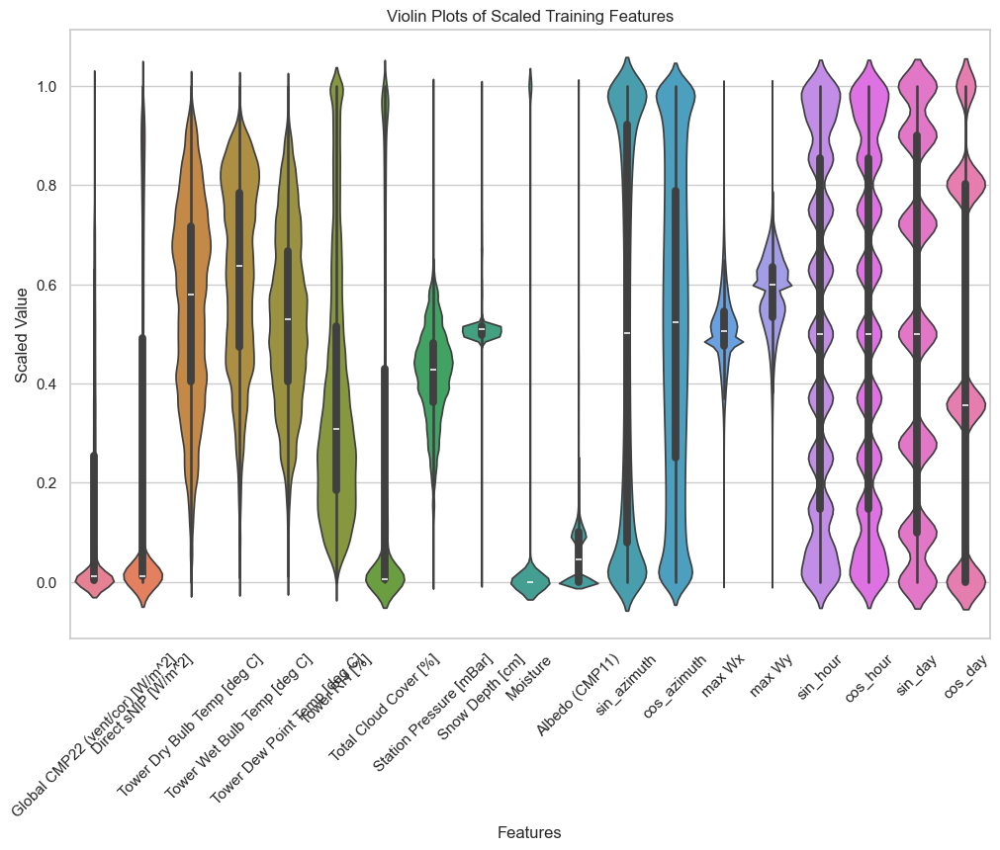

In [5]:
# Convert the scaled data back to DataFrame to plot violin plots
train_data_scaled_df = pd.DataFrame(train_data_scaled, columns=train_data.columns)
test_data_scaled_df = pd.DataFrame(test_data_scaled, columns=test_data.columns)

# Plot violin plots for scaled training data
plt.figure(figsize=(12, 8))
sns.violinplot(data=train_data_scaled_df)
plt.title('Violin Plots of Scaled Training Features')
plt.ylabel('Scaled Value')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.show()

In [6]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


# Checking the output from the generator



In [7]:
import tensorflow as tf

def weighted_rmse(weights_zero, weights_nonzero):
    """
    This function returns a loss function that computes the weighted root mean squared error (RMSE).
    Errors on zero values and non-zero values are weighted differently.
    
    Args:
    weights_zero: The weight for errors where the true values are zero.
    weights_nonzero: The weight for errors where the true values are non-zero.
    """
    def loss(y_true, y_pred):
        # Create a mask for zero and non-zero values
        is_zero = tf.cast(tf.equal(y_true, 0), tf.float32)
        is_nonzero = 1 - is_zero
        
        # Calculate squared error
        sq_error = tf.square(y_true - y_pred)
        
        # Apply different weights to zero and non-zero errors
        weighted_sq_error = (is_zero * weights_zero + is_nonzero * weights_nonzero) * sq_error
        
        # Calculate mean of weighted squared error and then take the square root
        mean_weighted_sq_error = tf.reduce_mean(weighted_sq_error)
        rmse = tf.sqrt(mean_weighted_sq_error)
        
        return rmse
    
    return loss

# Example usage in a Keras model
#model.compile(optimizer='adam', loss=weighted_rmse(weights_zero=0.1, weights_nonzero=0.9))


In [8]:
# Define configurations
lstm_layer_configs = [
    [100], [32, 64,64], [32, 64, 128], [32, 64, 128, 256], [256, 128, 64, 32],
    [128, 64, 32], [64, 32], [32, 64, 128, 256, 128, 64, 32], [32, 32, 32],
    [64, 64, 64], [128, 128, 128], [32, 64, 64, 128, 32, 64]
]
dense_layer_configs = [
    [32,64], [128], [64, 128], [128, 64]
]

# Store combinations in a list
configurations = [(lstm, dense) for lstm in lstm_layer_configs for dense in dense_layer_configs]


In [9]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense,Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import optimizers, metrics, losses


def build_model(num_lstm_layers, lstm_units, num_dense_layers, dense_units, input_shape):
    model = Sequential()
    for i in range(num_lstm_layers):
        if i == 0:
            # First LSTM layer with input shape
            model.add(LSTM(lstm_units[i], return_sequences=(i < num_lstm_layers - 1), input_shape=input_shape))
            model.add(Dropout(0.2))
        else:
            model.add(LSTM(lstm_units[i], return_sequences=(i < num_lstm_layers - 1)))
            model.add(Dropout(0.2))

    for i in range(num_dense_layers):
        model.add(Dense(dense_units[i], activation='relu'))
        model.add(Dropout(0.2))

    model.add(Dense(1))
    
    model.compile(optimizer=Adam(), loss=weighted_rmse(weights_zero=0.2, weights_nonzero=0.8), metrics=[metrics.RootMeanSquaredError(), 'mae'])
    return model
 


In [10]:
import numpy as np
import joblib
import tensorflow as tf
from tqdm import tqdm
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import math
import plotly.graph_objs as go
from tensorflow.keras.callbacks import EarlyStopping

# Add EarlyStopping to your model fitting process
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


# Load the saved scaler (assuming it was saved after fitting to the training data)

def run_model(lstm_units, dense_units, input_shape, train_gen, test_gen):
    num_lstm_layers = len(lstm_units)
    num_dense_layers = len(dense_units)
    print(f"Building model with {num_lstm_layers} LSTM layers and {num_dense_layers} Dense layers")

    model = build_model(num_lstm_layers, lstm_units, num_dense_layers, dense_units, input_shape)
    print(model.summary())

    # Train the model
    history = model.fit(train_gen, epochs=20, validation_data=test_gen,callbacks=[early_stopping])

    # Evaluate the model on the scaled test data
    test_loss, test_rmse, test_mae = model.evaluate(test_gen)
    print(f'Test Loss (scaled): {test_loss}, Test RMSE (scaled): {test_rmse}, Test MAE (scaled): {test_mae}')

    # Make predictions on the test data with a progress bar
    predictions = []
    true_labels = []
    for i in tqdm(range(len(test_gen)), desc='Predicting', unit='batch'):
        x_test, y_test = test_gen[i]
        pred = model.predict(x_test, verbose=0)
        predictions.append(pred)
        true_labels.append(y_test)
    
    # Concatenate all predictions and true labels
    # Concatenate all predictions and true labels
    # Concatenate all predictions and true labels
    testPredict = np.concatenate(predictions).reshape(-1, 1)
    testY = np.concatenate(true_labels).reshape(-1, 1)

    # Repeat predictions to match the shape of the original data
    testPredict_repeated = np.repeat(testPredict, 19, axis=-1)
    testY_repeated = np.repeat(testY, 19, axis=-1)

    # Inverse transform the repeated arrays
    testPredict_original = scaler.inverse_transform(testPredict_repeated)[:, label_column_index]
    testY_original = scaler.inverse_transform(testY_repeated)[:, label_column_index]

    # Calculate evaluation metrics on the original scale
    test_rmse_original = math.sqrt(mean_squared_error(testY_original, testPredict_original))
    test_mae_original = mean_absolute_error(testY_original, testPredict_original)
    test_r2_original = r2_score(testY_original, testPredict_original)
    
    print(f'Test RMSE (original scale): {test_rmse_original}')
    print(f'Test MAE (original scale): {test_mae_original}')
    print(f'Test R² (original scale): {test_r2_original}')

    
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(x=list(range(len(testY_original))), y=testY_original, mode='lines', name='True Values'))
    fig.add_trace(go.Scatter(x=list(range(len(testPredict_original))), y=testPredict_original, mode='lines', name='Predicted Values'))

    fig.update_layout(title='True vs Predicted Values', xaxis_title='Index', yaxis_title='Value', template='plotly_dark')
    
    fig.show()
    
    return history, test_loss, test_rmse_original, test_mae_original, test_r2_original

In [ ]:
forecast_horizons = [30]
models = {}
weights = {15: 0.5, 25: 0.35, 30: 0.15}
# Define configurations
lstm_layer_configs = [
    [100], [32, 64,64], [32, 64, 128], [32, 64, 128, 256], [256, 128, 64, 32],
    [128, 64, 32], [64, 32], [32, 64, 128, 256, 128, 64, 32], [32, 32, 32],
    [64, 64, 64], [128, 128, 128], [32, 64, 64, 128, 32, 64]
]
dense_layer_configs = [
    [32,64], [128], [64, 128], [128, 64]
]

# Store combinations in a list
configurations = [(lstm, dense) for lstm in lstm_layer_configs for dense in dense_layer_configs]




for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 0  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)
    
weighted_sum = sum(weights[horizon] * models[horizon][4] for horizon in forecast_horizons)

print(f"Weighted Sum of R² Scores: {weighted_sum}")

Training model for 30-minute ahead prediction:
Building model with 1 LSTM layers and 2 Dense layers
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100)               48000     
                                                                 
 dropout (Dropout)           (None, 100)               0         
                                                                 
 dense (Dense)               (None, 32)                3232      
                                                                 
 dropout_1 (Dropout)         (None, 32)                0         
                                                                 
 dense_1 (Dense)             (None, 64)                2112      
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                      

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_input_windows_and_targets(generator, num_sequences=10):
    # Fetch data from the generator
    X, y = [], []
    for i in range(num_sequences):
        data, labels = generator[i]
        X.append(data)
        y.append(labels)

    # Convert list to numpy array for easier indexing
    X = np.vstack(X)  # Stacking vertically
    y = np.concatenate(y)  # Flatten the labels array

    # Plotting
    fig, axs = plt.subplots(num_sequences, 1, figsize=(12, num_sequences * 2), sharex=True)
    for i in range(num_sequences):
        axs[i].plot(range(generator.look_back), X[i, :, 6], label='Input Window')  # Assuming column index 6 for the example
        axs[i].scatter(generator.look_back + generator.step_ahead - 1, y[i], color='red', label='Target')  # Point at target
        axs[i].legend()
        axs[i].set_title(f'Sequence {i+1} with Target')
    plt.xlabel('Time Steps')
    plt.show()


In [ ]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


forecast_horizons = [1, 25, 30,15]
models = {}



for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 4  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)




Training model for 1-minute ahead prediction:
Building model with 2 LSTM layers and 1 Dense layers


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_44 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_45 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,713 (139.50 KB)

 Trainable params: 35,713 (139.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13565/13565 ━━━━━━━━━━━━━━━━━━━━ 124s 9ms/step - loss: 0.0313 - mae: 0.0215 - root_mean_squared_error: 0.0424 - val_loss: 0.0091 - val_mae: 0.0080 - val_root_mean_squared_error: 0.0173
Epoch 2/5
13565/13565 ━━━━━━━━━━━━━━━━━━━━ 121s 9ms/step - loss: 0.0159 - mae: 0.0097 - root_mean_squared_error: 0.0206 - val_loss: 0.0077 - val_mae: 0.0065 - val_root_mean_squared_error: 0.0150
Epoch 3/5
13565/13565 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0153 - mae: 0.0090 - root_mean_squared_error: 0.0204 - val_loss: 0.0076 - val_mae: 0.0064 - val_root_mean_squared_error: 0.0151
Epoch 4/5
13565/13565 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0148 - mae: 0.0087 - root_mean_squared_error: 0.0198 - val_loss: 0.0085 - val_mae: 0.0074 - val_root_mean_squared_error: 0.0159
Epoch 5/5
13565/13565 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0147 - mae: 0.0085 - root_mean_squared_error: 0.0194 - val_loss: 0.0070 - val_mae: 0.0057 - val_root_mean_squared_error: 0.0148
1505/1505 ━━━━━━━━━━

Predicting: 100%|██████████| 1505/1505 [01:18<00:00, 19.26batch/s]


Test RMSE (original scale): 1.500697745121504
Test MAE (original scale): 0.5815833800327441
Test R² (original scale): 0.9964317826386573


Training model for 25-minute ahead prediction:
Building model with 2 LSTM layers and 1 Dense layers


Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_46 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_23 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_47 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,713 (139.50 KB)

 Trainable params: 35,713 (139.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 123s 9ms/step - loss: 0.0992 - mae: 0.0607 - root_mean_squared_error: 0.1170 - val_loss: 0.0343 - val_mae: 0.0329 - val_root_mean_squared_error: 0.0851
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0852 - mae: 0.0491 - root_mean_squared_error: 0.1008 - val_loss: 0.0332 - val_mae: 0.0317 - val_root_mean_squared_error: 0.0816
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0828 - mae: 0.0472 - root_mean_squared_error: 0.0977 - val_loss: 0.0329 - val_mae: 0.0315 - val_root_mean_squared_error: 0.0813
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0807 - mae: 0.0460 - root_mean_squared_error: 0.0953 - val_loss: 0.0361 - val_mae: 0.0346 - val_root_mean_squared_error: 0.0840
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0790 - mae: 0.0448 - root_mean_squared_error: 0.0933 - val_loss: 0.0367 - val_mae: 0.0354 - val_root_mean_squared_error: 0.0836
1504/1504 ━━━━━━━━━━

Predicting: 100%|██████████| 1504/1504 [01:22<00:00, 18.15batch/s]


Test RMSE (original scale): 8.615337476669351
Test MAE (original scale): 3.3240257066773906
Test R² (original scale): 0.882471125594279


Training model for 30-minute ahead prediction:
Building model with 2 LSTM layers and 1 Dense layers


Model: "sequential_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_48 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_49 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,713 (139.50 KB)

 Trainable params: 35,713 (139.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 125s 9ms/step - loss: 0.1093 - mae: 0.0673 - root_mean_squared_error: 0.1293 - val_loss: 0.0380 - val_mae: 0.0374 - val_root_mean_squared_error: 0.0895
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0914 - mae: 0.0531 - root_mean_squared_error: 0.1078 - val_loss: 0.0378 - val_mae: 0.0370 - val_root_mean_squared_error: 0.0894
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 123s 9ms/step - loss: 0.0892 - mae: 0.0515 - root_mean_squared_error: 0.1050 - val_loss: 0.0374 - val_mae: 0.0364 - val_root_mean_squared_error: 0.0916
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 123s 9ms/step - loss: 0.0865 - mae: 0.0497 - root_mean_squared_error: 0.1022 - val_loss: 0.0373 - val_mae: 0.0361 - val_root_mean_squared_error: 0.0911
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 123s 9ms/step - loss: 0.0844 - mae: 0.0483 - root_mean_squared_error: 0.0995 - val_loss: 0.0465 - val_mae: 0.0460 - val_root_mean_squared_error: 0.0969
1504/1504 ━━━━━━━━━━

Predicting: 100%|██████████| 1504/1504 [01:19<00:00, 19.03batch/s]


Test RMSE (original scale): 9.058035663800732
Test MAE (original scale): 3.786262962275905
Test R² (original scale): 0.870085977428967


Training model for 15-minute ahead prediction:
Building model with 2 LSTM layers and 1 Dense layers


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_50 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_51 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,713 (139.50 KB)

 Trainable params: 35,713 (139.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 124s 9ms/step - loss: 0.0797 - mae: 0.0491 - root_mean_squared_error: 0.0957 - val_loss: 0.0292 - val_mae: 0.0274 - val_root_mean_squared_error: 0.0638
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 121s 9ms/step - loss: 0.0653 - mae: 0.0372 - root_mean_squared_error: 0.0780 - val_loss: 0.0287 - val_mae: 0.0272 - val_root_mean_squared_error: 0.0630
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0636 - mae: 0.0357 - root_mean_squared_error: 0.0759 - val_loss: 0.0284 - val_mae: 0.0266 - val_root_mean_squared_error: 0.0637
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0621 - mae: 0.0348 - root_mean_squared_error: 0.0743 - val_loss: 0.0271 - val_mae: 0.0254 - val_root_mean_squared_error: 0.0612
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 122s 9ms/step - loss: 0.0612 - mae: 0.0344 - root_mean_squared_error: 0.0731 - val_loss: 0.0259 - val_mae: 0.0240 - val_root_mean_squared_error: 0.0614
1504/1504 ━━━━━━━━━━

Predicting: 100%|██████████| 1504/1504 [01:17<00:00, 19.50batch/s]


Test RMSE (original scale): 6.455926434374034
Test MAE (original scale): 2.773278153688148
Test R² (original scale): 0.9340005492595481


In [ ]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


forecast_horizons = [30,15]
models = {}



for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 9  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)




Training model for 30-minute ahead prediction:
Building model with 3 LSTM layers and 1 Dense layers


Model: "sequential_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_64 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_32 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_65 (LSTM)                  │ (None, 75, 64)         │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_66 (LSTM)                  │ (None, 128)            │        98,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 146,945 (574.00 KB)

 Trainable params: 146,945 (574.00 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 163s 12ms/step - loss: 0.1095 - mae: 0.0675 - root_mean_squared_error: 0.1288 - val_loss: 0.0449 - val_mae: 0.0449 - val_root_mean_squared_error: 0.0967
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0931 - mae: 0.0536 - root_mean_squared_error: 0.1096 - val_loss: 0.0369 - val_mae: 0.0358 - val_root_mean_squared_error: 0.0917
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0894 - mae: 0.0510 - root_mean_squared_error: 0.1054 - val_loss: 0.0369 - val_mae: 0.0358 - val_root_mean_squared_error: 0.0910
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 162s 12ms/step - loss: 0.0877 - mae: 0.0499 - root_mean_squared_error: 0.1034 - val_loss: 0.0384 - val_mae: 0.0374 - val_root_mean_squared_error: 0.0940
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 162s 12ms/step - loss: 0.0857 - mae: 0.0486 - root_mean_squared_error: 0.1011 - val_loss: 0.0373 - val_mae: 0.0366 - val_root_mean_squared_error: 0.0889
1504/1504 ━━━━━

Predicting: 100%|██████████| 1504/1504 [01:20<00:00, 18.67batch/s]


Test RMSE (original scale): 9.7842055954179
Test MAE (original scale): 4.540131638866271
Test R² (original scale): 0.8484209721047716


Training model for 15-minute ahead prediction:
Building model with 3 LSTM layers and 1 Dense layers


Model: "sequential_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_67 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_33 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_68 (LSTM)                  │ (None, 75, 64)         │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_69 (LSTM)                  │ (None, 128)            │        98,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 146,945 (574.00 KB)

 Trainable params: 146,945 (574.00 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 163s 12ms/step - loss: 0.0801 - mae: 0.0487 - root_mean_squared_error: 0.0958 - val_loss: 0.0321 - val_mae: 0.0306 - val_root_mean_squared_error: 0.0673
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 160s 12ms/step - loss: 0.0657 - mae: 0.0372 - root_mean_squared_error: 0.0784 - val_loss: 0.0333 - val_mae: 0.0322 - val_root_mean_squared_error: 0.0668
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 160s 12ms/step - loss: 0.0637 - mae: 0.0358 - root_mean_squared_error: 0.0760 - val_loss: 0.0281 - val_mae: 0.0262 - val_root_mean_squared_error: 0.0653
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0621 - mae: 0.0347 - root_mean_squared_error: 0.0741 - val_loss: 0.0301 - val_mae: 0.0286 - val_root_mean_squared_error: 0.0628
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0611 - mae: 0.0341 - root_mean_squared_error: 0.0728 - val_loss: 0.0287 - val_mae: 0.0272 - val_root_mean_squared_error: 0.0619
1504/1504 ━━━━━

Predicting: 100%|██████████| 1504/1504 [01:19<00:00, 18.81batch/s]


Test RMSE (original scale): 6.812243055962137
Test MAE (original scale): 3.098452539442121
Test R² (original scale): 0.9265141968336312


In [ ]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


forecast_horizons = [30,15]
models = {}



for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 36  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)




Training model for 30-minute ahead prediction:
Building model with 3 LSTM layers and 1 Dense layers


Model: "sequential_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_70 (LSTM)                  │ (None, 75, 64)         │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_34 (Dropout)            │ (None, 75, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_71 (LSTM)                  │ (None, 75, 64)         │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_72 (LSTM)                  │ (None, 64)             │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 91,777 (358.50 KB)

 Trainable params: 91,777 (358.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 160s 12ms/step - loss: 0.1076 - mae: 0.0657 - root_mean_squared_error: 0.1266 - val_loss: 0.0378 - val_mae: 0.0368 - val_root_mean_squared_error: 0.0936
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 160s 12ms/step - loss: 0.0919 - mae: 0.0527 - root_mean_squared_error: 0.1083 - val_loss: 0.0394 - val_mae: 0.0390 - val_root_mean_squared_error: 0.0896
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 160s 12ms/step - loss: 0.0889 - mae: 0.0508 - root_mean_squared_error: 0.1051 - val_loss: 0.0366 - val_mae: 0.0357 - val_root_mean_squared_error: 0.0892
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0874 - mae: 0.0496 - root_mean_squared_error: 0.1031 - val_loss: 0.0385 - val_mae: 0.0378 - val_root_mean_squared_error: 0.0914
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 160s 12ms/step - loss: 0.0842 - mae: 0.0476 - root_mean_squared_error: 0.0994 - val_loss: 0.0382 - val_mae: 0.0375 - val_root_mean_squared_error: 0.0915
1504/1504 ━━━━━

Predicting: 100%|██████████| 1504/1504 [01:29<00:00, 16.81batch/s]


Test RMSE (original scale): 9.470152910339992
Test MAE (original scale): 3.719320868714631
Test R² (original scale): 0.857995547919366


Training model for 15-minute ahead prediction:
Building model with 3 LSTM layers and 1 Dense layers


Model: "sequential_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_73 (LSTM)                  │ (None, 75, 64)         │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_35 (Dropout)            │ (None, 75, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_74 (LSTM)                  │ (None, 75, 64)         │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_75 (LSTM)                  │ (None, 64)             │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 91,777 (358.50 KB)

 Trainable params: 91,777 (358.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 163s 12ms/step - loss: 0.0787 - mae: 0.0474 - root_mean_squared_error: 0.0946 - val_loss: 0.0272 - val_mae: 0.0254 - val_root_mean_squared_error: 0.0622
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 162s 12ms/step - loss: 0.0649 - mae: 0.0364 - root_mean_squared_error: 0.0777 - val_loss: 0.0294 - val_mae: 0.0274 - val_root_mean_squared_error: 0.0647
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0631 - mae: 0.0355 - root_mean_squared_error: 0.0753 - val_loss: 0.0272 - val_mae: 0.0255 - val_root_mean_squared_error: 0.0608
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0616 - mae: 0.0343 - root_mean_squared_error: 0.0734 - val_loss: 0.0267 - val_mae: 0.0249 - val_root_mean_squared_error: 0.0604
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 161s 12ms/step - loss: 0.0600 - mae: 0.0335 - root_mean_squared_error: 0.0716 - val_loss: 0.0260 - val_mae: 0.0242 - val_root_mean_squared_error: 0.0611
1504/1504 ━━━━━

Predicting: 100%|██████████| 1504/1504 [01:21<00:00, 18.36batch/s]


Test RMSE (original scale): 6.295903128503413
Test MAE (original scale): 2.566198954996908
Test R² (original scale): 0.9372318614048945


In [ ]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


forecast_horizons = [30,15]
models = {}



for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 28  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)




Training model for 30-minute ahead prediction:
Building model with 7 LSTM layers and 1 Dense layers


Model: "sequential_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_76 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_36 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_77 (LSTM)                  │ (None, 75, 64)         │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_78 (LSTM)                  │ (None, 75, 128)        │        98,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_79 (LSTM)                  │ (None, 75, 256)        │       394,240 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_80 (LSTM)                  │ (None, 75, 128)        │       197,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_81 (LSTM)                  │ (None, 75, 64)         │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_82 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 64)             │         2,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 785,665 (3.00 MB)

 Trainable params: 785,665 (3.00 MB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 322s 23ms/step - loss: 0.1143 - mae: 0.0705 - root_mean_squared_error: 0.1353 - val_loss: 0.0679 - val_mae: 0.0712 - val_root_mean_squared_error: 0.1484
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 318s 23ms/step - loss: 0.1652 - mae: 0.1118 - root_mean_squared_error: 0.1901 - val_loss: 0.0605 - val_mae: 0.0630 - val_root_mean_squared_error: 0.1364
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 319s 24ms/step - loss: 0.1531 - mae: 0.1003 - root_mean_squared_error: 0.1768 - val_loss: 0.0551 - val_mae: 0.0569 - val_root_mean_squared_error: 0.1183
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 323s 24ms/step - loss: 0.1258 - mae: 0.0793 - root_mean_squared_error: 0.1465 - val_loss: 0.0449 - val_mae: 0.0455 - val_root_mean_squared_error: 0.1024
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 322s 24ms/step - loss: 0.1030 - mae: 0.0611 - root_mean_squared_error: 0.1208 - val_loss: 0.0438 - val_mae: 0.0434 - val_root_mean_squared_error: 0.0993
1504/1504 ━━━━━

Predicting: 100%|██████████| 1504/1504 [01:34<00:00, 15.87batch/s]


Test RMSE (original scale): 15.017383125031394
Test MAE (original scale): 7.205710904323174
Test R² (original scale): 0.6429109779143586


Training model for 15-minute ahead prediction:
Building model with 7 LSTM layers and 1 Dense layers


Model: "sequential_37"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_83 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_37 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_84 (LSTM)                  │ (None, 75, 64)         │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_85 (LSTM)                  │ (None, 75, 128)        │        98,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_86 (LSTM)                  │ (None, 75, 256)        │       394,240 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_87 (LSTM)                  │ (None, 75, 128)        │       197,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_88 (LSTM)                  │ (None, 75, 64)         │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_89 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 64)             │         2,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 785,665 (3.00 MB)

 Trainable params: 785,665 (3.00 MB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 326s 24ms/step - loss: 0.0835 - mae: 0.0505 - root_mean_squared_error: 0.1001 - val_loss: 0.0283 - val_mae: 0.0266 - val_root_mean_squared_error: 0.0632
Epoch 2/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 318s 23ms/step - loss: 0.0751 - mae: 0.0436 - root_mean_squared_error: 0.0901 - val_loss: 0.0355 - val_mae: 0.0345 - val_root_mean_squared_error: 0.0693
Epoch 3/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 324s 24ms/step - loss: 0.0704 - mae: 0.0403 - root_mean_squared_error: 0.0839 - val_loss: 0.0352 - val_mae: 0.0341 - val_root_mean_squared_error: 0.0665
Epoch 4/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 321s 24ms/step - loss: 0.0648 - mae: 0.0367 - root_mean_squared_error: 0.0773 - val_loss: 0.0275 - val_mae: 0.0258 - val_root_mean_squared_error: 0.0639
Epoch 5/5
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 321s 24ms/step - loss: 0.0629 - mae: 0.0353 - root_mean_squared_error: 0.0750 - val_loss: 0.0283 - val_mae: 0.0266 - val_root_mean_squared_error: 0.0607
1504/1504 ━━━━━

Predicting: 100%|██████████| 1504/1504 [01:38<00:00, 15.23batch/s]


Test RMSE (original scale): 6.396918229137045
Test MAE (original scale): 2.6871951853340215
Test R² (original scale): 0.9352015266729405


In [ ]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


forecast_horizons = [30,15]
models = {}



for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 4  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)




Training model for 30-minute ahead prediction:
Building model with 3 LSTM layers and 2 Dense layers


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_9 (LSTM)                   │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_10 (LSTM)                  │ (None, 75, 64)         │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 75, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_11 (LSTM)                  │ (None, 64)             │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_15 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 70,785 (276.50 KB)

 Trainable params: 70,785 (276.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 194s 14ms/step - loss: 0.1234 - mae: 0.0842 - root_mean_squared_error: 0.1437 - val_loss: 0.0441 - val_mae: 0.0444 - val_root_mean_squared_error: 0.0935
Epoch 2/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 190s 14ms/step - loss: 0.1032 - mae: 0.0699 - root_mean_squared_error: 0.1201 - val_loss: 0.0510 - val_mae: 0.0518 - val_root_mean_squared_error: 0.0960
Epoch 3/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 195s 14ms/step - loss: 0.1010 - mae: 0.0686 - root_mean_squared_error: 0.1175 - val_loss: 0.0456 - val_mae: 0.0452 - val_root_mean_squared_error: 0.0998
Epoch 4/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 193s 14ms/step - loss: 0.0986 - mae: 0.0673 - root_mean_squared_error: 0.1148 - val_loss: 0.0404 - val_mae: 0.0392 - val_root_mean_squared_error: 0.0952
Epoch 5/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 192s 14ms/step - loss: 0.0968 - mae: 0.0659 - root_mean_squared_error: 0.1127 - val_loss: 0.0395 - val_mae: 0.0385 - val_root_mean_squared_error: 0.0931
Epoch 6/20

Predicting: 100%|██████████| 1504/1504 [01:34<00:00, 16.00batch/s]


Test RMSE (original scale): 9.561706120409443
Test MAE (original scale): 3.720529898122157
Test R² (original scale): 0.855236604677226


Training model for 15-minute ahead prediction:
Building model with 3 LSTM layers and 2 Dense layers


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_12 (LSTM)                  │ (None, 75, 32)         │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_16 (Dropout)            │ (None, 75, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_13 (LSTM)                  │ (None, 75, 64)         │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_17 (Dropout)            │ (None, 75, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_14 (LSTM)                  │ (None, 64)             │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_18 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_19 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_20 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 70,785 (276.50 KB)

 Trainable params: 70,785 (276.50 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 192s 14ms/step - loss: 0.0994 - mae: 0.0689 - root_mean_squared_error: 0.1170 - val_loss: 0.0338 - val_mae: 0.0328 - val_root_mean_squared_error: 0.0672
Epoch 2/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 192s 14ms/step - loss: 0.0803 - mae: 0.0559 - root_mean_squared_error: 0.0935 - val_loss: 0.0293 - val_mae: 0.0272 - val_root_mean_squared_error: 0.0707
Epoch 3/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 194s 14ms/step - loss: 0.0780 - mae: 0.0546 - root_mean_squared_error: 0.0908 - val_loss: 0.0301 - val_mae: 0.0287 - val_root_mean_squared_error: 0.0641
Epoch 4/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 195s 14ms/step - loss: 0.0764 - mae: 0.0537 - root_mean_squared_error: 0.0889 - val_loss: 0.0319 - val_mae: 0.0307 - val_root_mean_squared_error: 0.0623
Epoch 5/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 195s 14ms/step - loss: 0.0759 - mae: 0.0534 - root_mean_squared_error: 0.0883 - val_loss: 0.0308 - val_mae: 0.0294 - val_root_mean_squared_error: 0.0638
Epoch 6/20

Predicting: 100%|██████████| 1504/1504 [01:35<00:00, 15.76batch/s]


Test RMSE (original scale): 7.153176668531573
Test MAE (original scale): 2.7530175147778433
Test R² (original scale): 0.9189746197018815


In [ ]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


forecast_horizons = [30,15]
models = {}



for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 0  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)




Training model for 30-minute ahead prediction:
Building model with 1 LSTM layers and 1 Dense layers


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_15 (LSTM)                  │ (None, 32)             │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_21 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,745 (30.25 KB)

 Trainable params: 7,745 (30.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 94s 7ms/step - loss: 0.1237 - mae: 0.0855 - root_mean_squared_error: 0.1446 - val_loss: 0.0434 - val_mae: 0.0427 - val_root_mean_squared_error: 0.0952
Epoch 2/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 91s 7ms/step - loss: 0.1029 - mae: 0.0702 - root_mean_squared_error: 0.1196 - val_loss: 0.0380 - val_mae: 0.0372 - val_root_mean_squared_error: 0.0915
Epoch 3/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 93s 7ms/step - loss: 0.1006 - mae: 0.0686 - root_mean_squared_error: 0.1170 - val_loss: 0.0379 - val_mae: 0.0370 - val_root_mean_squared_error: 0.0896
Epoch 4/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 93s 7ms/step - loss: 0.0990 - mae: 0.0674 - root_mean_squared_error: 0.1153 - val_loss: 0.0418 - val_mae: 0.0416 - val_root_mean_squared_error: 0.0895
Epoch 5/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 93s 7ms/step - loss: 0.0980 - mae: 0.0667 - root_mean_squared_error: 0.1140 - val_loss: 0.0366 - val_mae: 0.0356 - val_root_mean_squared_error: 0.0881
1504/1504 ━━━━━━━━━━

Predicting: 100%|██████████| 1504/1504 [01:29<00:00, 16.75batch/s]


Test RMSE (original scale): 9.634861063834496
Test MAE (original scale): 4.320858566573977
Test R² (original scale): 0.8530130120284819


Training model for 15-minute ahead prediction:
Building model with 1 LSTM layers and 1 Dense layers


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_16 (LSTM)                  │ (None, 32)             │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_23 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,745 (30.25 KB)

 Trainable params: 7,745 (30.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 93s 7ms/step - loss: 0.0955 - mae: 0.0675 - root_mean_squared_error: 0.1129 - val_loss: 0.0315 - val_mae: 0.0300 - val_root_mean_squared_error: 0.0640
Epoch 2/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 92s 7ms/step - loss: 0.0782 - mae: 0.0545 - root_mean_squared_error: 0.0913 - val_loss: 0.0286 - val_mae: 0.0269 - val_root_mean_squared_error: 0.0638
Epoch 3/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 93s 7ms/step - loss: 0.0763 - mae: 0.0531 - root_mean_squared_error: 0.0890 - val_loss: 0.0275 - val_mae: 0.0256 - val_root_mean_squared_error: 0.0612
Epoch 4/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 93s 7ms/step - loss: 0.0755 - mae: 0.0527 - root_mean_squared_error: 0.0880 - val_loss: 0.0293 - val_mae: 0.0279 - val_root_mean_squared_error: 0.0628
Epoch 5/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 93s 7ms/step - loss: 0.0746 - mae: 0.0521 - root_mean_squared_error: 0.0869 - val_loss: 0.0282 - val_mae: 0.0265 - val_root_mean_squared_error: 0.0621
Epoch 6/20
13564/135

Predicting: 100%|██████████| 1504/1504 [01:26<00:00, 17.42batch/s]


Test RMSE (original scale): 6.1957355860566485
Test MAE (original scale): 2.5861370152126297
Test R² (original scale): 0.9392132497731905


In [ ]:
# Define configurations
lstm_layer_configs = [
    [32], [32, 64,64], [32, 64, 128], [32, 64, 128, 256], [256, 128, 64, 32],
    [128, 64, 32], [64, 32], [32, 64, 128, 256, 128, 64, 32], [32, 32, 32],
    [64, 64, 64], [128, 128, 128], [32, 64, 64, 128, 32, 64]
]
dense_layer_configs = [
    [32,64], [128], [64, 128], [128, 64]
]

# Store combinations in a list
configurations = [(lstm, dense) for lstm in lstm_layer_configs for dense in dense_layer_configs]


In [ ]:
# Convert the DataFrames to NumPy arrays
train_data_scaled = np.asarray(train_data_scaled).astype(np.float32)
test_data_scaled = np.asarray(test_data_scaled).astype(np.float32)





class TimeSeriesGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, look_back=75, step_ahead=30, batch_size=32, shuffle=True, target_column_index=-1):
        'Initialization'
        self.data = data
        self.look_back = look_back
        self.step_ahead = step_ahead
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.target_column_index = target_column_index
        self.indices = np.arange(len(data) - look_back - step_ahead + 1)
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.indices) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        # Generate data
        X, y = self.__data_generation(batch_indices)
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.indices)

    def __data_generation(self, batch_indices):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, self.look_back, self.data.shape[1]))
        y = np.empty((self.batch_size,))
        
        for i, idx in enumerate(batch_indices):
            X[i,] = self.data[idx:idx + self.look_back]
            y[i,] = self.data[idx + self.look_back + self.step_ahead - 1, self.target_column_index]
                

        return X, y


    


forecast_horizons = [30,15]
models = {}



for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 0  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)




Training model for 30-minute ahead prediction:
Building model with 1 LSTM layers and 2 Dense layers


Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_17 (LSTM)                  │ (None, 32)             │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_26 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 64)             │         2,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,889 (38.63 KB)

 Trainable params: 9,889 (38.63 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 100s 7ms/step - loss: 0.1222 - mae: 0.0829 - root_mean_squared_error: 0.1430 - val_loss: 0.0454 - val_mae: 0.0460 - val_root_mean_squared_error: 0.0951
Epoch 2/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 98s 7ms/step - loss: 0.1007 - mae: 0.0649 - root_mean_squared_error: 0.1175 - val_loss: 0.0432 - val_mae: 0.0431 - val_root_mean_squared_error: 0.0929
Epoch 3/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 98s 7ms/step - loss: 0.0975 - mae: 0.0626 - root_mean_squared_error: 0.1140 - val_loss: 0.0416 - val_mae: 0.0411 - val_root_mean_squared_error: 0.0927
Epoch 4/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 98s 7ms/step - loss: 0.0957 - mae: 0.0617 - root_mean_squared_error: 0.1120 - val_loss: 0.0415 - val_mae: 0.0414 - val_root_mean_squared_error: 0.0892
Epoch 5/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 99s 7ms/step - loss: 0.0944 - mae: 0.0608 - root_mean_squared_error: 0.1104 - val_loss: 0.0436 - val_mae: 0.0431 - val_root_mean_squared_error: 0.0920
1504/1504 ━━━━━━━━━

Predicting: 100%|██████████| 1504/1504 [01:31<00:00, 16.49batch/s]


Test RMSE (original scale): 9.621731128633426
Test MAE (original scale): 4.6511237138856485
Test R² (original scale): 0.853413352958373


Training model for 15-minute ahead prediction:
Building model with 1 LSTM layers and 2 Dense layers


Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_18 (LSTM)                  │ (None, 32)             │         6,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_28 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_29 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 64)             │         2,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_30 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,889 (38.63 KB)

 Trainable params: 9,889 (38.63 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 100s 7ms/step - loss: 0.0950 - mae: 0.0661 - root_mean_squared_error: 0.1128 - val_loss: 0.0323 - val_mae: 0.0313 - val_root_mean_squared_error: 0.0669
Epoch 2/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 99s 7ms/step - loss: 0.0760 - mae: 0.0508 - root_mean_squared_error: 0.0891 - val_loss: 0.0335 - val_mae: 0.0327 - val_root_mean_squared_error: 0.0653
Epoch 3/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 98s 7ms/step - loss: 0.0732 - mae: 0.0488 - root_mean_squared_error: 0.0860 - val_loss: 0.0342 - val_mae: 0.0334 - val_root_mean_squared_error: 0.0624
Epoch 4/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 100s 7ms/step - loss: 0.0716 - mae: 0.0475 - root_mean_squared_error: 0.0839 - val_loss: 0.0281 - val_mae: 0.0266 - val_root_mean_squared_error: 0.0627
Epoch 5/20
13564/13564 ━━━━━━━━━━━━━━━━━━━━ 100s 7ms/step - loss: 0.0710 - mae: 0.0472 - root_mean_squared_error: 0.0833 - val_loss: 0.0335 - val_mae: 0.0327 - val_root_mean_squared_error: 0.0629
1504/1504 ━━━━━━━

Predicting: 100%|██████████| 1504/1504 [01:25<00:00, 17.50batch/s]


Test RMSE (original scale): 6.7648431784595875
Test MAE (original scale): 3.1649982654367315
Test R² (original scale): 0.9275332737661086


In [ ]:
forecast_horizons = [30]
models = {}
weights = {15: 0.5, 25: 0.35, 30: 0.15}
# Define configurations
lstm_layer_configs = [
    [100], [32, 64,64], [32, 64, 128], [32, 64, 128, 256], [256, 128, 64, 32],
    [128, 64, 32], [64, 32], [32, 64, 128, 256, 128, 64, 32], [32, 32, 32],
    [64, 64, 64], [128, 128, 128], [32, 64, 64, 128, 32, 64]
]
dense_layer_configs = [
    [32,64], [128], [64, 128], [128, 64]
]

# Store combinations in a list
configurations = [(lstm, dense) for lstm in lstm_layer_configs for dense in dense_layer_configs]




for horizon in forecast_horizons:
    print(f"Training model for {horizon}-minute ahead prediction:")
    # Create generators for each horizon
    train_gen = TimeSeriesGenerator(train_data_scaled, step_ahead=horizon, batch_size=32, shuffle=True, target_column_index=6)
    test_gen = TimeSeriesGenerator(test_data_scaled, step_ahead=horizon, batch_size=32, shuffle=False, target_column_index=6)
    input_shape = (train_gen.look_back, train_data_scaled.shape[1])
    
    #plot_input_windows_and_targets(train_gen, num_sequences=5)

    
    # Model dimensions
    config_index = 0  # Adjust this index to run different configurations
    lstm_units, dense_units = configurations[config_index]
    # Run the model training and evaluation
    history, test_loss, test_rmse, test_mae,test_r2_original = run_model(lstm_units, dense_units, input_shape, train_gen, test_gen)
    models[horizon] = (history, test_loss, test_rmse, test_mae,test_r2_original)
    
weighted_sum = sum(weights[horizon] * models[horizon][4] for horizon in forecast_horizons)

print(f"Weighted Sum of R² Scores: {weighted_sum}")


In [ ]:
scaler = MinMaxScaler()
# Get the index of the label column
label_column = "Total Cloud Cover [%]"
label_column_index = data.columns.get_loc(label_column)

# Determine the split point (e.g., 80% training, 20% testing)
split_point = int(len(data) * 0.9)

# Split the data into training and testing sets
train_data = data.iloc[:split_point]
test_data = data.iloc[split_point:]

train_data_scaled = scaler.fit_transform(train_data)
test_data_scaled = scaler.transform(test_data)